In [2]:
from moseq2_detectron_extract.io.session import Session
import matplotlib.pyplot as plt
import numpy as np
import cv2
from frr import FastReflectionRemoval

from moseq2_detectron_extract.proc.proc import prep_raw_frames, clean_frames, get_frame_features, colorize_video


In [3]:
session = Session(r"H:\Tischfield_Lab_ISI\MoSeq\moseq2\Raw_Data\Dulin_Lab\DREADDs Cohort- Ashley Tucker\Week 9 Post Transplantation Post CNO\session_20220819105327.tar.gz")
first_frame, bground_im, roi, true_depth = session.find_roi()

In [4]:
def plot_frames(frames, idxs, cols=5, fig_size=(20,20), vmin=0, vmax=100):
    cols = int(cols)
    rows = int(np.ceil(frames.shape[0] / cols))
    fig, axs = plt.subplots(rows, cols, sharex=True, sharey=True, figsize=fig_size)
    
    for i, ax in enumerate(axs.flat):
        if i >= frames.shape[0]:
            ax.axis('off')
            continue

        im = ax.imshow(frames[i], vmin=vmin, vmax=vmax)
        ax.set_title(idxs[i])
    fig.colorbar(im)
    fig.tight_layout()

def plot_contours(frames, contours, idxs, cols=5, fig_size=(20,20), vmin=0, vmax=100):
    cols = int(cols)
    rows = int(np.ceil(frames.shape[0] / cols))
    fig, axs = plt.subplots(rows, cols, sharex=True, sharey=True, figsize=fig_size)
    norm = plt.Normalize(vmin, vmax)
    cmap = plt.get_cmap('jet')
    
    disp_img = frames.copy().astype('float32')
    disp_img = (disp_img-vmin)/(vmax-vmin)
    disp_img[disp_img < 0] = 0
    disp_img[disp_img > 1] = 1
    disp_img = cmap(disp_img)[:,:,:,:3]*255
    
    for i, ax in enumerate(axs.flat):
        cv2.drawContours(disp_img[i], [contours[i]], -1, (0,255,255), 1)
        ax.imshow(disp_img[i])
        ax.set_title(idxs[i])
    fig.tight_layout()

In [5]:
frames_of_interest = range(200, 300)
frame_idxs, raw_frames = next(session.index(frames_of_interest))

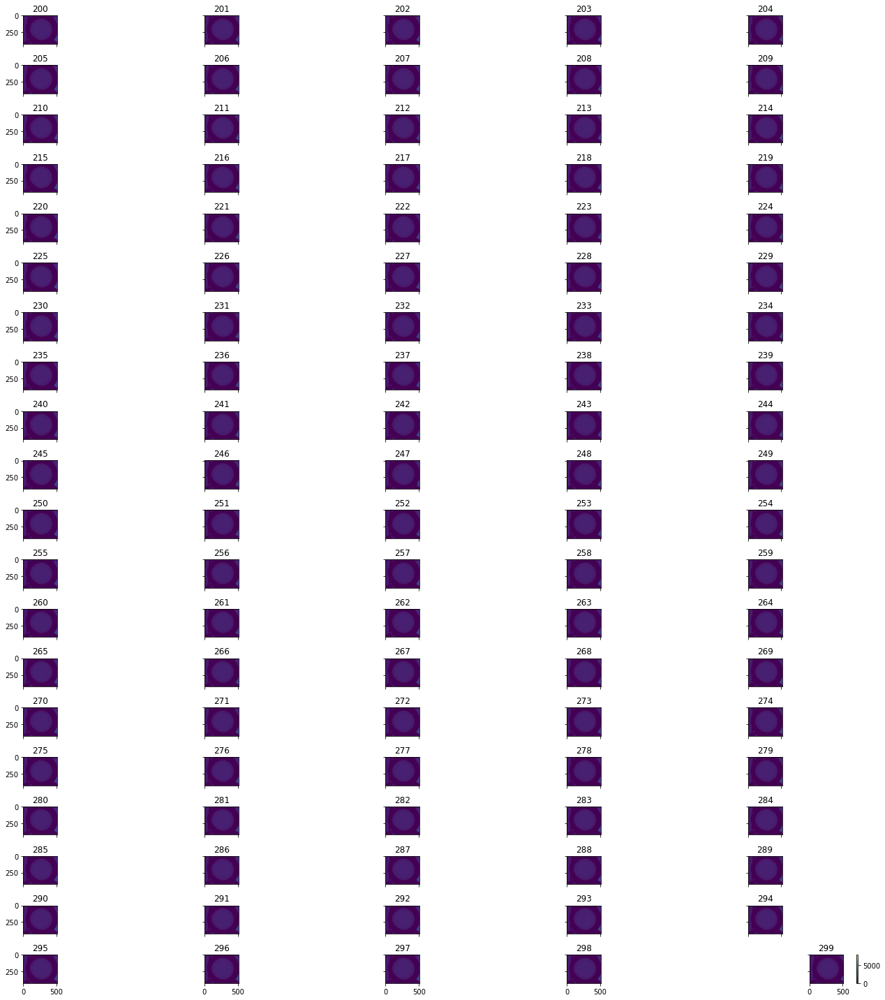

In [6]:
plot_frames(raw_frames, frame_idxs, vmin=None, vmax=None)

(100, 248, 253)


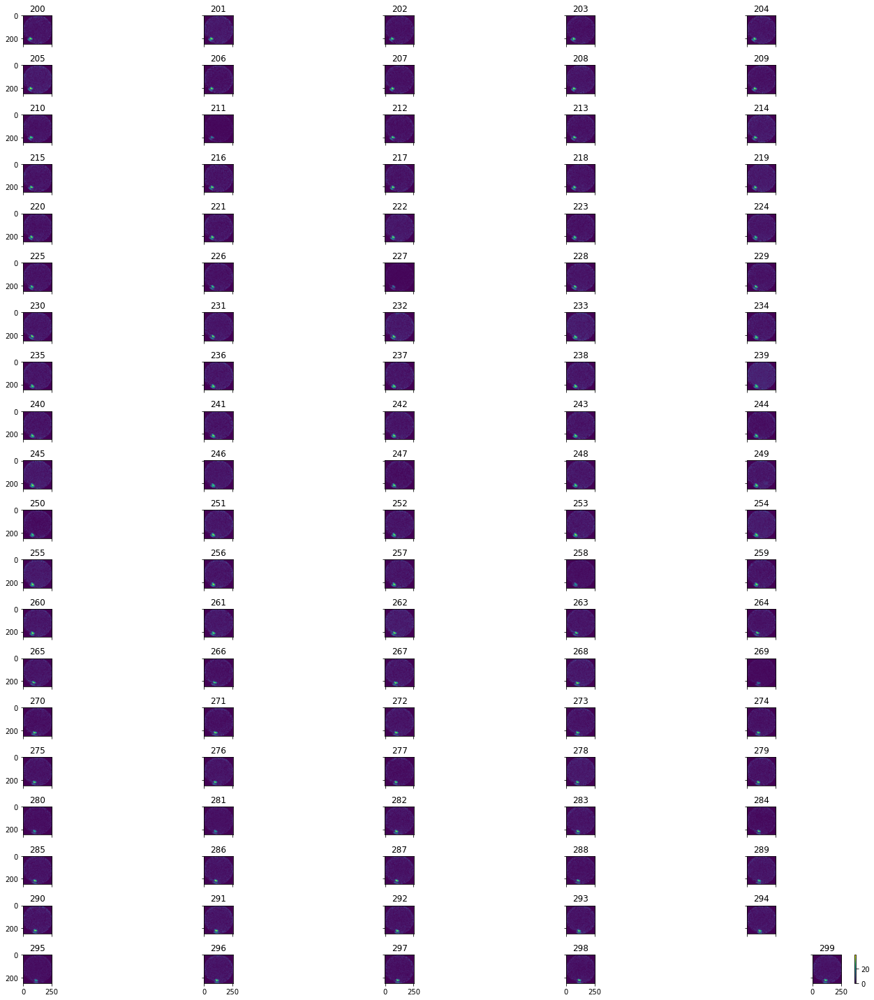

In [7]:
prepped_frames = prep_raw_frames(raw_frames.copy(), bground_im=bground_im, roi=roi, vmin=0, vmax=100, fix_invalid_pixels=True)
plot_frames(prepped_frames, frame_idxs, vmin=0, vmax=None)
print(prepped_frames.shape)

C:\Users\thackray\AppData\Local\Temp/ipykernel_20644/2658181238.py:13: MatplotlibDeprecationWarning: Starting from Matplotlib 3.6, colorbar() will steal space from the mappable's axes, rather than from the current axes, to place the colorbar.  To silence this warning, explicitly pass the 'ax' argument to colorbar().
  fig.colorbar(im)


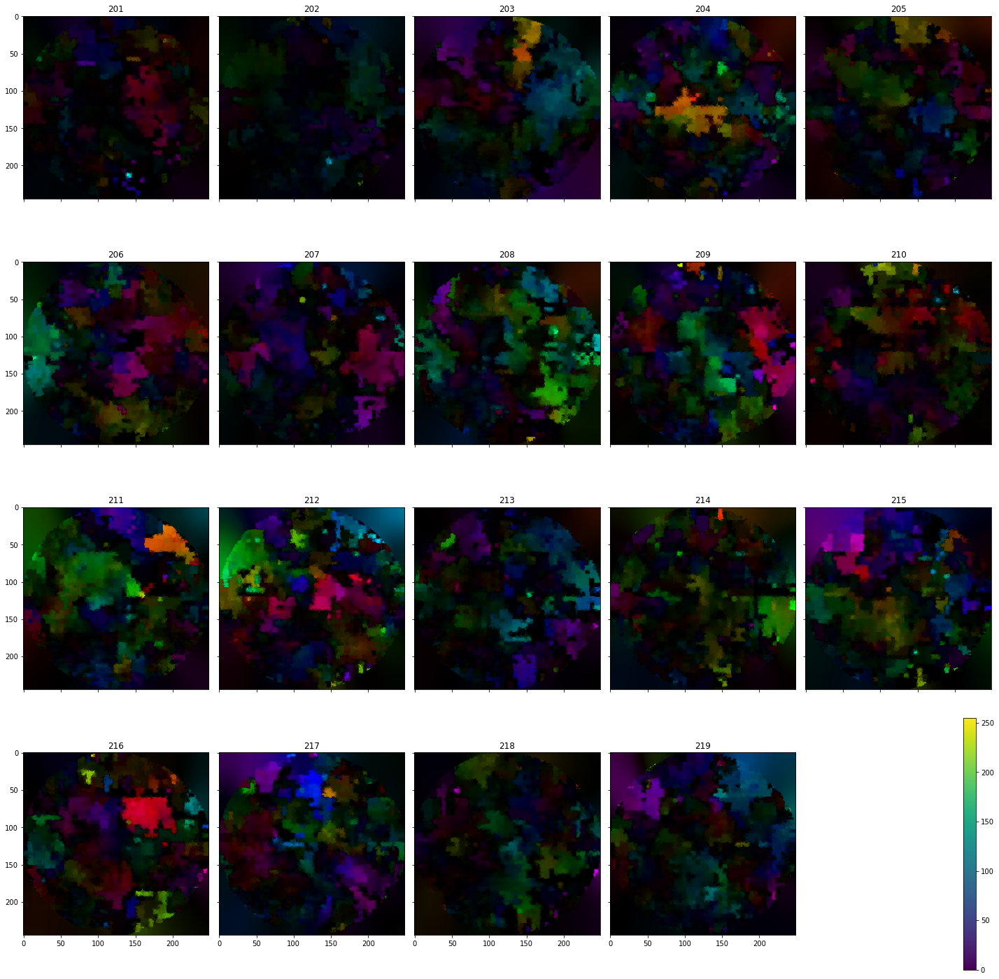

In [8]:
def optical_flow_Franeback(prev, next):
    return cv2.calcOpticalFlowFarneback(prev, next, None, pyr_scale=0.5, levels=6, winsize=50, iterations=3, poly_n=7, poly_sigma=1.5, flags=0)

def optical_flow_RLOF(prev, next):
    rlof_param = cv2.optflow.RLOFOpticalFlowParameter()
    return cv2.optflow.calcOpticalFlowDenseRLOF(colorize_video(prev), colorize_video(next), None, rlofParam=rlof_param)

flow_imgs = []
hsv = np.zeros((prepped_frames.shape[1], prepped_frames.shape[2], 3), dtype='uint8')
hsv[..., 1] = 255
for i in range(1, prepped_frames.shape[0]):
    prev = prepped_frames[i-1]
    next = prepped_frames[i]
    #flow = optical_flow_Franeback(prev, next)
    flow = optical_flow_RLOF(prev, next)
    mag, ang = cv2.cartToPolar(flow[..., 0], flow[..., 1])
    #print(hsv.shape, mag.shape, ang.shape)
    hsv[..., 0] = ang*180/np.pi/2
    hsv[..., 2] = cv2.normalize(mag, None, 0, 255, cv2.NORM_MINMAX)
    bgr = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)
    flow_imgs.append(bgr)

plot_frames(np.array(flow_imgs), frame_idxs[1:], vmin=None, vmax=None)

In [22]:
from sklearn.decomposition import PCA, KernelPCA

pca_train_frame_idxs, pca_train_raw_frames = next(session.index(range(200, 300)))
pca_train_preped_frames = prep_raw_frames(pca_train_raw_frames.copy(), bground_im=bground_im, roi=roi, vmin=0, vmax=100, fix_invalid_pixels=True)
pca_input = pca_train_preped_frames.reshape((pca_train_preped_frames.shape[0], -1))
print("train set shape:", pca_input.shape)

params = []
for gi, g in enumerate(np.linspace(1.0/pca_input.shape[1], 1.0, 50)):
    for nci, nc in enumerate(np.linspace(10, 10000, 50)):
        params.append({'pca': {'kernel': 'rbf', 'gamma': g, 'n_components': nc}, 'gi': gi, 'nci': nci})

rows = gi+2
cols = nci+2
fig, axs = plt.subplots(rows, cols, figsize=(6*rows, 6*cols))
axs[0, 0].imshow(pca_train_preped_frames[0], vmin=0, vmax=50)
axs[0, 0].set_title("origional")

for i, ps in enumerate(params):
    try:
        pca = KernelPCA(fit_inverse_transform=True, **ps['pca'])
        pca.fit(pca_input)
        inverse = pca.inverse_transform(pca.transform(pca_train_preped_frames.reshape((pca_train_preped_frames.shape[0], -1))))
        inverse = inverse.reshape(pca_train_preped_frames.shape)

        row = ps['gi'] + 1
        col = ps['nci'] + 1
        axs[row, col].imshow(inverse[0], vmin=0, vmax=50)
        axs[row, col].set_title(str(ps))
    except:
        continue



train set shape: (100, 60756)


In [18]:
np.swapaxes(prepped_frames.reshape((prepped_frames.shape[0], -1)), 0, 1).shape

(61005, 20)

In [1]:
pca_train_preped_frames.shape

NameError: name 'pca_train_preped_frames' is not defined